# Explore here

### 1. Bloque de código para las bibliotecas que vamos a ir necesitando

In [123]:
import os
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.metrics import mean_squared_error, r2_score



###  2. Almacenamos la base de datos con la que vamos a trabajar y comprobamos que es correcta.

In [124]:
# Your c# Paso 1: Crear carpeta para almacenar datos en crudo
os.makedirs('./data/raw', exist_ok=True)

# Paso 2: Descargar y almacenar el archivo
url = "https://raw.githubusercontent.com/4GeeksAcademy/regularized-linear-regression-project-tutorial/main/demographic_health_data.csv"
file_path = './data/raw/demographic_health_data.csv'
data = pd.read_csv(url)

# Guardar una copia local en la carpeta indicada
data.to_csv(file_path, index=False)

# Paso 3: Cargar el conjunto de datos
# Verificamos las primeras filas para inspeccionar la estructura y composición del conjunto de datos
data = pd.read_csv(file_path)
data.head()


,fips,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,40-49 y/o % of total pop,50-59,50-59 y/o % of total pop,60-69,60-69 y/o % of total pop,70-79,70-79 y/o % of total pop,80+,80+ y/o % of total pop,White-alone pop,% White-alone,Black-alone pop,% Black-alone,Native American/American Indian-alone pop,% NA/AI-alone,Asian-alone pop,% Asian-alone,Hawaiian/Pacific Islander-alone pop,% Hawaiian/PI-alone,Two or more races pop,% Two or more races,POP_ESTIMATE_2018,N_POP_CHG_2018,GQ_ESTIMATES_2018,R_birth_2018,R_death_2018,R_NATURAL_INC_2018,R_INTERNATIONAL_MIG_2018,R_DOMESTIC_MIG_2018,R_NET_MIG_2018,Less than a high school diploma 2014-18,High school diploma only 2014-18,Some college or associate's degree 2014-18,Bachelor's degree or higher 2014-18,Percent of adults with less than a high school diploma 2014-18,Percent of adults with a high school diploma only 2014-18,Percent of adults completing some college or associate's degree 2014-18,Percent of adults with a bachelor's degree or higher 2014-18,POVALL_2018,PCTPOVALL_2018,PCTPOV017_2018,PCTPOV517_2018,MEDHHINC_2018,CI90LBINC_2018,CI90UBINC_2018,Civilian_labor_force_2018,Employed_2018,Unemployed_2018,Unemployment_rate_2018,Median_Household_Income_2018,Med_HH_Income_Percent_of_State_Total_2018,Active Physicians per 100000 Population 2018 (AAMC),Total Active Patient Care Physicians per 100000 Population 2018 (AAMC),Active Primary Care Physicians per 100000 Population 2018 (AAMC),Active Patient Care Primary Care Physicians per 100000 Population 2018 (AAMC),Active General Surgeons per 100000 Population 2018 (AAMC),Active Patient Care General Surgeons per 100000 Population 2018 (AAMC),Total nurse practitioners (2019),Total physician assistants (2019),Total Hospitals (2019),Internal Medicine Primary Care (2019),Family Medicine/General Practice Primary Care (2019),Total Specialist Physicians (2019),ICU Beds_x,Total Population,Population Aged 60+,Percent of Population Aged 60+,COUNTY_NAME,STATE_NAME,STATE_FIPS,CNTY_FIPS,county_pop2018_18 and older,anycondition_prevalence,anycondition_Lower 95% CI,anycondition_Upper 95% CI,anycondition_number,Obesity_prevalence,Obesity_Lower 95% CI,Obesity_Upper 95% CI,Obesity_number,Heart disease_prevalence,Heart disease_Lower 95% CI,Heart disease_Upper 95% CI,Heart disease_number,COPD_prevalence,COPD_Lower 95% CI,COPD_Upper 95% CI,COPD_number,diabetes_prevalence,diabetes_Lower 95% CI,diabetes_Upper 95% CI,diabetes_number,CKD_prevalence,CKD_Lower 95% CI,CKD_Upper 95% CI,CKD_number,Urban_rural_code
0,1001,55601,6787,12.206615,7637,13.735364,6878,12.370281,7089,12.749771,7582,13.636445,7738,13.917016,5826,10.478229,4050,7.284042,2014,3.622237,42660,76.725239,10915,19.630942,267,0.480207,681,1.224798,62,0.111509,1016,1.827305,55601,158,455,11.8,9.6,2.2,0.0,0.7,0.6,4204,12119,10552,10291,11.3,32.6,28.4,27.7,7587,13.8,19.3,19.5,59338,53628,65048,25957,25015,942,3.6,59338,119.0,217.1,196.7,77.2,71.2,7.6,6.9,28.859137,6.085786,1.148905,25.992561,21.249061,72.142154,6,55036,10523,19.1,Autauga,Alabama,1,1,42438,47.6,45.4,49.4,20181,35.8,34.2,37.3,15193,7.9,7.2,8.7,3345,8.6,7.3,9.9,3644,12.9,11.9,13.8,5462,3.1,2.9,3.3,1326,3
1,1003,218022,24757,11.355276,26913,12.344167,23579,10.814964,25213,11.564429,27338,12.539102,29986,13.753658,29932,13.728890,20936,9.602701,9368,4.296814,190301,87.285228,19492,8.940382,1684,0.772399,2508,1.150343,146,0.066966,3891,1.784682,218022,5403,2190,10.5,10.3,0.1,0.5,24.3,24.8,14310,40579,46025,46075,9.7,27.6,31.3,31.3,21069,9.8,13.9,13.1,57588,54437,60739,93849,90456,3393,3.6,57588,115.5,217.1,196.7,77.2,71.2,7.6,6.9,113.162114,23.863512,4.505074,101.921730,83.321572,282.882982,51,203360,53519,26.3,Baldwin,Alabama,1,3,170912,40.2,38.2,42.3,68790,29.7,28.4,31.0,50761,7.8,7.0,8.7,13414,8.6,7.2,10.1,14692,12.0,11.0,13.1,20520,3.2,3.0,3.5,5479,4
2,1005,24881,2732,10.980266,2960,11.896628,3268,13.134520,3201,12.865239,3074,12.354809,3278,13.174712,3076,12.3

In [125]:
#Cargar el diccionario de variables

dict_path = './data/raw/data_dict (1).csv'
data_dict = pd.read_csv(dict_path, encoding='latin1')  # Prueba con 'latin1'

### 3. Conociendo el Data Set

In [126]:
# Obtener las dimensiones
print('Filas , Columnas')
data.shape

Filas , Columnas


(3140, 108)

In [127]:
# Obtener información sobre tipos de datos y valores no nulos
data.info

<bound method DataFrame.info of        fips   TOT_POP      0-9  0-9 y/o % of total pop   19-Oct  \
0      1001     55601     6787               12.206615     7637   
1      1003    218022    24757               11.355276    26913   
2      1005     24881     2732               10.980266     2960   
3      1007     22400     2456               10.964286     2596   
4      1009     57840     7095               12.266598     7570   
5      1011     10138     1198               11.816926     1130   
6      1013     19680     2351               11.946138     2461   
7      1015    114277    13141               11.499252    14637   
8      1017     33615     3869               11.509743     3812   
9      1019     26032     2554                9.811002     2981   
10     1021     44153     5652               12.800942     5818   
11     1023     12841     1324               10.310723     1489   
12     1025     23920     2704               11.304348     3045   
13     1027     13275     1420

In [128]:
pd.set_option('display.max_rows', None)
# Intentar leer el archivo con una codificación alternativa
data_dict = pd.read_csv(dict_path, encoding='latin1')

# Mostrar las primeras filas del diccionario de variables nuevamente
data_dict_head = data_dict.head()
data_dict_info = data_dict.info()
data_dict

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 117 entries, 0 to 116
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Feature     109 non-null    object
 1   Unnamed: 1  48 non-null     object
 2   Unnamed: 2  4 non-null      object
dtypes: object(3)
memory usage: 2.9+ KB


,Feature,Unnamed: 1,Unnamed: 2
0,fips,FIPS Code for the County,NaN
1,TOT_POP,Total Population,This data as well as all Age and Race data is ...
2,0-9,Population aged 0-9,All of the other age columns are the same but ...
3,0-9 y/o % of total pop,% of the population aged 0-9,NaN
4,10-19',NaN,NaN
5,10-19 y/o % of total pop,NaN,NaN
6,20-29,NaN,NaN
7,20-29 y/o % of total pop,NaN,NaN
8,30-39,NaN,NaN
9,30-39 y/o % of total pop,NaN,NaN


In [129]:
pd.set_option('display.max_rows', None)
print(data.info)

<bound method DataFrame.info of        fips   TOT_POP      0-9  0-9 y/o % of total pop   19-Oct  \
0      1001     55601     6787               12.206615     7637   
1      1003    218022    24757               11.355276    26913   
2      1005     24881     2732               10.980266     2960   
3      1007     22400     2456               10.964286     2596   
4      1009     57840     7095               12.266598     7570   
5      1011     10138     1198               11.816926     1130   
6      1013     19680     2351               11.946138     2461   
7      1015    114277    13141               11.499252    14637   
8      1017     33615     3869               11.509743     3812   
9      1019     26032     2554                9.811002     2981   
10     1021     44153     5652               12.800942     5818   
11     1023     12841     1324               10.310723     1489   
12     1025     23920     2704               11.304348     3045   
13     1027     13275     1420

In [130]:
# Mostrar las primeras filas y las estadísticas básicas del conjunto de datos principal
data_head = data.head()
data_description = data.describe(include='all').transpose()
data_columns = data.columns

data_head, data_description, data_columns

(   fips  TOT_POP    0-9  0-9 y/o % of total pop  19-Oct  \
 0  1001    55601   6787               12.206615    7637   
 1  1003   218022  24757               11.355276   26913   
 2  1005    24881   2732               10.980266    2960   
 3  1007    22400   2456               10.964286    2596   
 4  1009    57840   7095               12.266598    7570   
 
    10-19 y/o % of total pop  20-29  20-29 y/o % of total pop  30-39  \
 0                 13.735364   6878                 12.370281   7089   
 1                 12.344167  23579                 10.814964  25213   
 2                 11.896628   3268                 13.134520   3201   
 3                 11.589286   3029                 13.522321   3113   
 4                 13.087828   6742                 11.656293   6884   
 
    30-39 y/o % of total pop  40-49  40-49 y/o % of total pop  50-59  \
 0                 12.749771   7582                 13.636445   7738   
 1                 11.564429  27338                 12.53910

Limpiando el diccionario para una mayor claridad

In [131]:
# Renombrar las columnas del diccionario para mayor claridad
data_dict.columns = ['Variable', 'Decripcion', 'Info_adicional']

# Eliminar filas donde todas las columnas son NaN
data_dict_cleaned = data_dict.dropna(how='all')

# Revisar las primeras filas después de la limpieza
data_dict_head = data_dict_cleaned.head()
data_dict_info = data_dict_cleaned.info()

data_dict_head, data_dict_info



<class 'pandas.core.frame.DataFrame'>
Index: 114 entries, 0 to 116
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Variable        109 non-null    object
 1   Decripcion      48 non-null     object
 2   Info_adicional  4 non-null      object
dtypes: object(3)
memory usage: 3.6+ KB


(                 Variable                    Decripcion  \
 0                    fips      FIPS Code for the County   
 1                 TOT_POP              Total Population   
 2                     0-9           Population aged 0-9   
 3  0-9 y/o % of total pop  % of the population aged 0-9   
 4                  10-19'                           NaN   
 
                                       Info_adicional  
 0                                                NaN  
 1  This data as well as all Age and Race data is ...  
 2  All of the other age columns are the same but ...  
 3                                                NaN  
 4                                                NaN  ,
 None)

In [132]:
data_dict

,Variable,Decripcion,Info_adicional
0,fips,FIPS Code for the County,NaN
1,TOT_POP,Total Population,This data as well as all Age and Race data is ...
2,0-9,Population aged 0-9,All of the other age columns are the same but ...
3,0-9 y/o % of total pop,% of the population aged 0-9,NaN
4,10-19',NaN,NaN
5,10-19 y/o % of total pop,NaN,NaN
6,20-29,NaN,NaN
7,20-29 y/o % of total pop,NaN,NaN
8,30-39,NaN,NaN
9,30-39 y/o % of total pop,NaN,NaN


#### Duplicados

In [133]:
duplicados = data.duplicated()
num_duplicados = duplicados.sum()
print(f"En este caso en contramos {num_duplicados} duplicados.")


En este caso en contramos 0 duplicados.


#### Nulos

In [134]:
data.isnull().sum()

fips                                                                             0
TOT_POP                                                                          0
0-9                                                                              0
0-9 y/o % of total pop                                                           0
19-Oct                                                                           0
10-19 y/o % of total pop                                                         0
20-29                                                                            0
20-29 y/o % of total pop                                                         0
30-39                                                                            0
30-39 y/o % of total pop                                                         0
40-49                                                                            0
40-49 y/o % of total pop                                                         0
50-5

### 4. Identificando variables

In [135]:
data.dtypes

fips                                                                               int64
TOT_POP                                                                            int64
0-9                                                                                int64
0-9 y/o % of total pop                                                           float64
19-Oct                                                                             int64
10-19 y/o % of total pop                                                         float64
20-29                                                                              int64
20-29 y/o % of total pop                                                         float64
30-39                                                                              int64
30-39 y/o % of total pop                                                         float64
40-49                                                                              int64
40-49 y/o % of total 

In [136]:
# Identificar las variables numéricas
variables_numericas = data._get_numeric_data().columns
print("Las variables numéricas son:")
for var in variables_numericas:
    print(f" - {var}")

# Identificar las variables categóricas
variables_categoricas = data.select_dtypes(include=['object']).columns
print("\nLas variables categóricas son:")
for var in variables_categoricas:
    print(f" - {var}")


Las variables numéricas son:
 - fips
 - TOT_POP
 - 0-9
 - 0-9 y/o % of total pop
 - 19-Oct
 - 10-19 y/o % of total pop
 - 20-29
 - 20-29 y/o % of total pop
 - 30-39
 - 30-39 y/o % of total pop
 - 40-49
 - 40-49 y/o % of total pop
 - 50-59
 - 50-59 y/o % of total pop
 - 60-69
 - 60-69 y/o % of total pop
 - 70-79
 - 70-79 y/o % of total pop
 - 80+
 - 80+ y/o % of total pop
 - White-alone pop
 - % White-alone
 - Black-alone pop
 - % Black-alone
 - Native American/American Indian-alone pop
 - % NA/AI-alone
 - Asian-alone pop
 - % Asian-alone
 - Hawaiian/Pacific Islander-alone pop
 - % Hawaiian/PI-alone
 - Two or more races pop
 - % Two or more races
 - POP_ESTIMATE_2018
 - N_POP_CHG_2018
 - GQ_ESTIMATES_2018
 - R_birth_2018
 - R_death_2018
 - R_NATURAL_INC_2018
 - R_INTERNATIONAL_MIG_2018
 - R_DOMESTIC_MIG_2018
 - R_NET_MIG_2018
 - Less than a high school diploma 2014-18
 - High school diploma only 2014-18
 - Some college or associate's degree 2014-18
 - Bachelor's degree or higher 2014-18

#### Variables categóricas

In [137]:


# Paso 2: Explorar la distribución de las categorías
for col in variables_categoricas:
    print(f"\nVariable categórica: {col}")
    print(data[col].value_counts())
    print(f"Cantidad de categorías únicas: {data[col].nunique()}")

# Paso 3: Codificar las variables categóricas (opcional, no ejecutado aquí)
# Si decides usar estas variables en un modelo, podemos codificarlas más adelante.



Variable categórica: COUNTY_NAME
COUNTY_NAME
Washington               31
Jefferson                26
Lincoln                  24
Franklin                 24
Jackson                  24
Madison                  20
Clay                     18
Union                    18
Montgomery               18
Monroe                   17
Marion                   17
Wayne                    16
Grant                    15
Greene                   14
Warren                   14
Carroll                  13
Marshall                 12
Douglas                  12
Polk                     12
Lake                     12
Adams                    12
Clark                    12
Lee                      12
Johnson                  12
Lawrence                 11
Fayette                  11
Crawford                 11
Scott                    11
Calhoun                  11
Morgan                   11
Perry                    10
Hamilton                 10
Logan                    10
Pike                     10
He

In [138]:
#data = data.drop(columns=['COUNTY_NAME'])

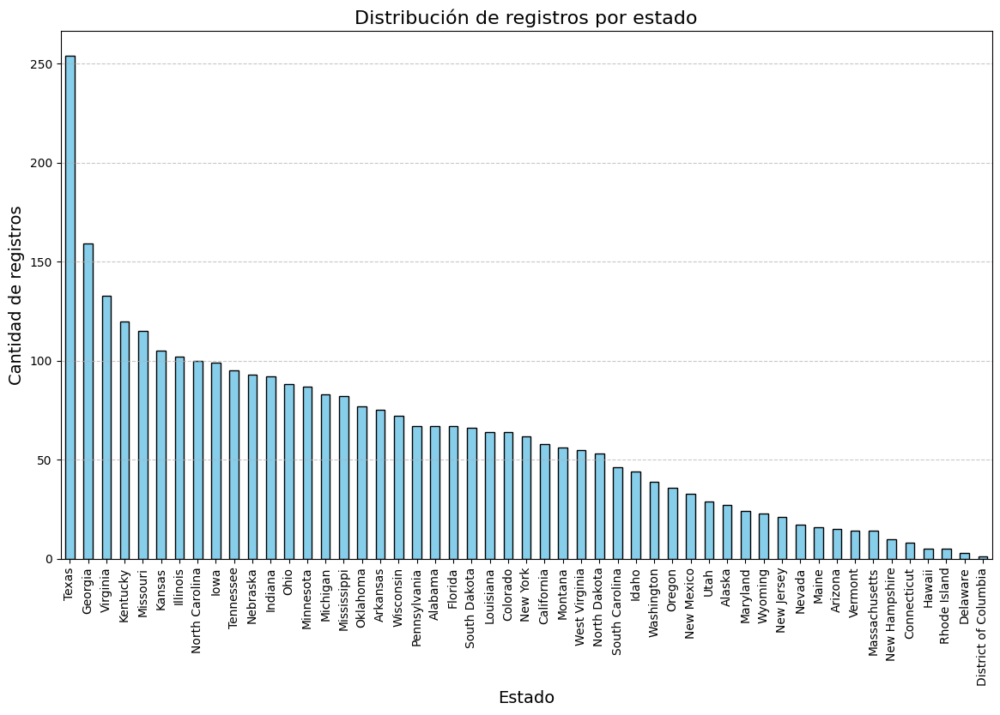

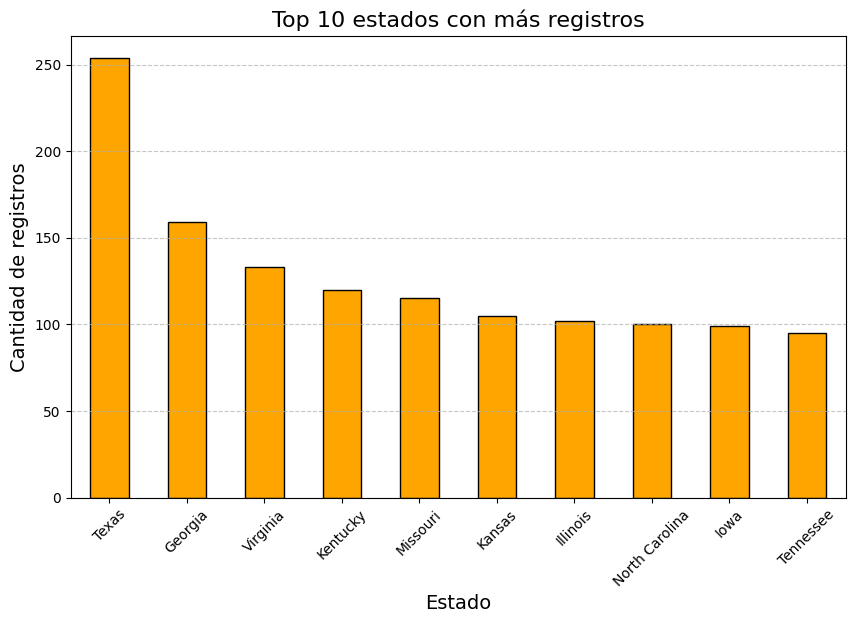

In [139]:
# Contar la frecuencia de cada estado
state_counts = data['STATE_NAME'].value_counts()

# Gráfico 1: Distribución completa de los registros por estado
plt.figure(figsize=(14, 8))
state_counts.plot(kind='bar', color='skyblue', edgecolor='black')
plt.title('Distribución de registros por estado', fontsize=16)
plt.xlabel('Estado', fontsize=14)
plt.ylabel('Cantidad de registros', fontsize=14)
plt.xticks(rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# Gráfico 2: Top 10 estados con más registros
plt.figure(figsize=(10, 6))
state_counts.head(10).plot(kind='bar', color='orange', edgecolor='black')
plt.title('Top 10 estados con más registros', fontsize=16)
plt.xlabel('Estado', fontsize=14)
plt.ylabel('Cantidad de registros', fontsize=14)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


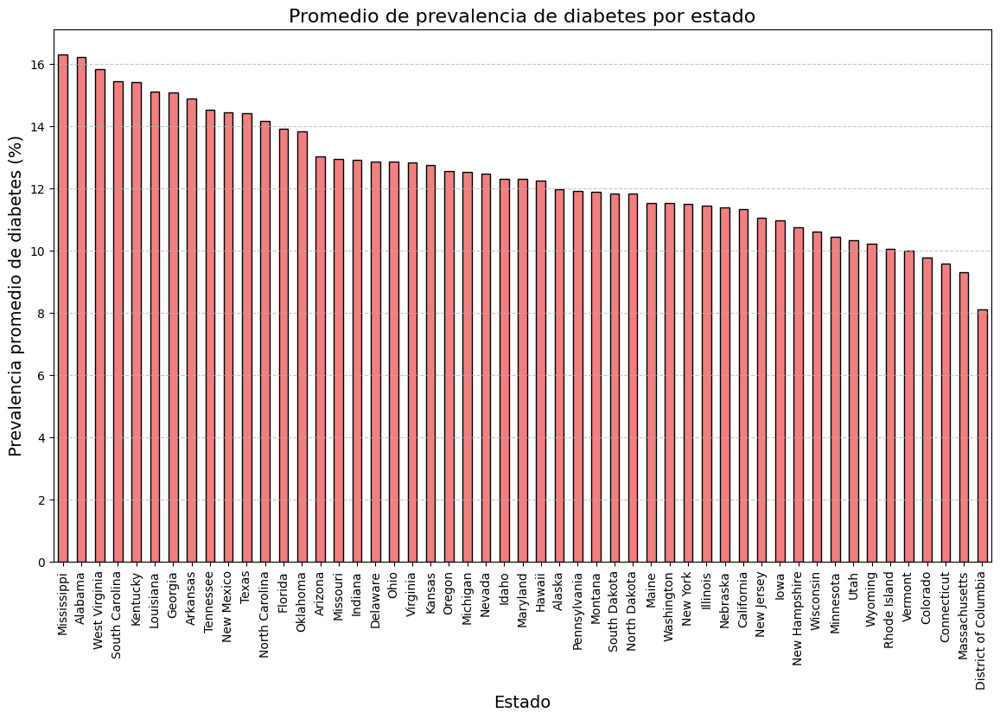

In [140]:
# Calcular el promedio de prevalencia de diabetes por estado
state_diabetes_avg = data.groupby('STATE_NAME')['diabetes_prevalence'].mean().sort_values(ascending=False)

# Gráfico: Promedio de prevalencia de diabetes por estado
plt.figure(figsize=(14, 8))
state_diabetes_avg.plot(kind='bar', color='lightcoral', edgecolor='black')
plt.title('Promedio de prevalencia de diabetes por estado', fontsize=16)
plt.xlabel('Estado', fontsize=14)
plt.ylabel('Prevalencia promedio de diabetes (%)', fontsize=14)
plt.xticks(rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


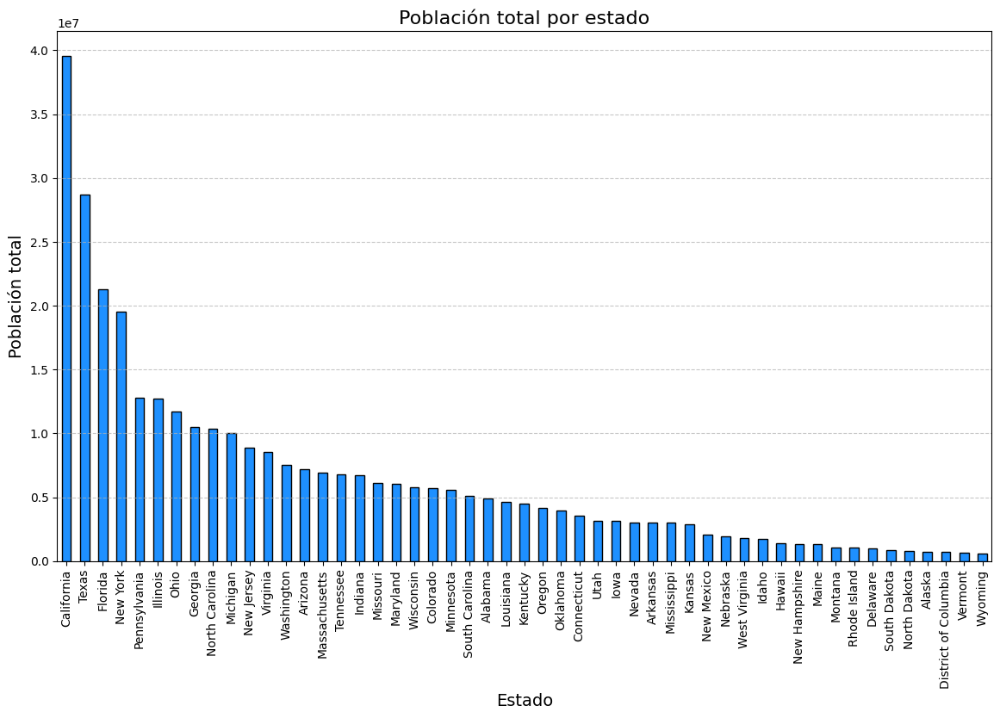

(STATE_NAME
 California      39557045
 Texas           28701845
 Florida         21299325
 New York        19542209
 Pennsylvania    12807060
 Name: TOT_POP, dtype: int64,
 STATE_NAME
 North Dakota            760077
 Alaska                  724759
 District of Columbia    702455
 Vermont                 626299
 Wyoming                 577737
 Name: TOT_POP, dtype: int64)

In [141]:
# Calcular la población total por estado
state_population_total = data.groupby('STATE_NAME')['TOT_POP'].sum().sort_values(ascending=False)

# Gráfico: Población total por estado
plt.figure(figsize=(14, 8))
state_population_total.plot(kind='bar', color='dodgerblue', edgecolor='black')
plt.title('Población total por estado', fontsize=16)
plt.xlabel('Estado', fontsize=14)
plt.ylabel('Población total', fontsize=14)
plt.xticks(rotation=90)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

# Mostrar los estados más y menos poblados
top_states_population = state_population_total.head(5)
bottom_states_population = state_population_total.tail(5)

top_states_population, bottom_states_population


Prevalencia de diabetes (diabetes_prevalence): ¿Los condados más poblados tienden a tener mayores tasas de diabetes?

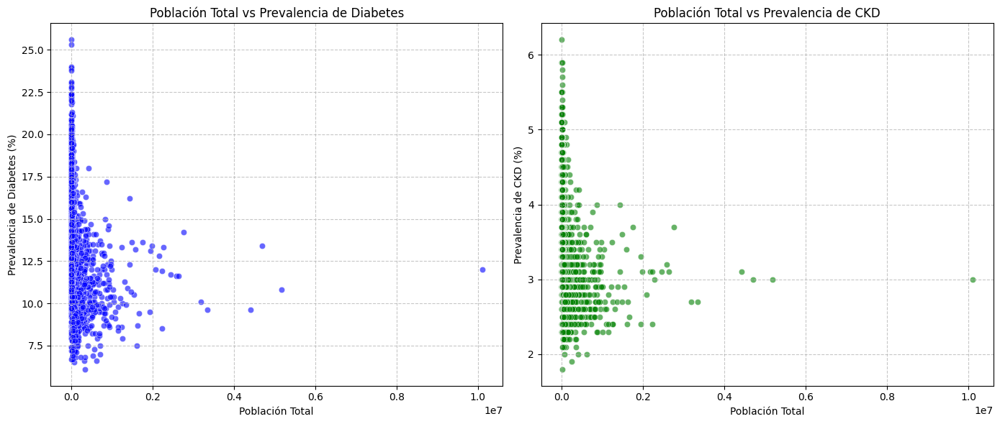

(np.float64(-0.17484326019295898), np.float64(-0.21873091411427573))

In [142]:
# Visualizar la relación entre TOT_POP y prevalencias de salud
plt.figure(figsize=(14, 6))

# Gráfico 1: Población total vs Prevalencia de diabetes
plt.subplot(1, 2, 1)
sns.scatterplot(x=data['TOT_POP'], y=data['diabetes_prevalence'], color='blue', alpha=0.6)
plt.title('Población Total vs Prevalencia de Diabetes')
plt.xlabel('Población Total')
plt.ylabel('Prevalencia de Diabetes (%)')
plt.grid(axis='both', linestyle='--', alpha=0.7)

# Gráfico 2: Población total vs Prevalencia de CKD
plt.subplot(1, 2, 2)
sns.scatterplot(x=data['TOT_POP'], y=data['CKD_prevalence'], color='green', alpha=0.6)
plt.title('Población Total vs Prevalencia de CKD')
plt.xlabel('Población Total')
plt.ylabel('Prevalencia de CKD (%)')
plt.grid(axis='both', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

# Calcular las correlaciones
correlation_diabetes = data['TOT_POP'].corr(data['diabetes_prevalence'])
correlation_ckd = data['TOT_POP'].corr(data['CKD_prevalence'])

correlation_diabetes, correlation_ckd


#### Gráficos de dispersión:
##### Población total vs Prevalencia de Diabetes:
  
- No se observa una relación clara.
- Algunos condados con poblaciones pequeñas tienen altas prevalencias de diabetes.

##### Población total vs Prevalencia de CKD:

- Similar al caso de diabetes.

##### Correlaciones:
- Diabetes: Correlación con población total es -0.17 (débil y negativa).
- CKD: Correlación con población total es -0.22 (débil y negativa).


Las correlaciones negativas débiles sugieren que los condados con poblaciones más grandes tienden a tener ligeramente menores prevalencias de estas enfermedades, pero la relación no es fuerte.

### Variables Numéricas

In [143]:
# Seleccionamos las variables numéricas únicamente para trabajarlas
numeric_data = data[variables_numericas]

# Calcular la matriz de correlación únicamente para datos numéricos
correlation_matrix = numeric_data.corr()

# Mostrar las primeras filas de la matriz de correlación
correlation_matrix


,fips,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,40-49 y/o % of total pop,50-59,50-59 y/o % of total pop,60-69,60-69 y/o % of total pop,70-79,70-79 y/o % of total pop,80+,80+ y/o % of total pop,White-alone pop,% White-alone,Black-alone pop,% Black-alone,Native American/American Indian-alone pop,% NA/AI-alone,Asian-alone pop,% Asian-alone,Hawaiian/Pacific Islander-alone pop,% Hawaiian/PI-alone,Two or more races pop,% Two or more races,POP_ESTIMATE_2018,N_POP_CHG_2018,GQ_ESTIMATES_2018,R_birth_2018,R_death_2018,R_NATURAL_INC_2018,R_INTERNATIONAL_MIG_2018,R_DOMESTIC_MIG_2018,R_NET_MIG_2018,Less than a high school diploma 2014-18,High school diploma only 2014-18,Some college or associate's degree 2014-18,Bachelor's degree or higher 2014-18,Percent of adults with less than a high school diploma 2014-18,Percent of adults with a high school diploma only 2014-18,Percent of adults completing some college or associate's degree 2014-18,Percent of adults with a bachelor's degree or higher 2014-18,POVALL_2018,PCTPOVALL_2018,PCTPOV017_2018,PCTPOV517_2018,MEDHHINC_2018,CI90LBINC_2018,CI90UBINC_2018,Civilian_labor_force_2018,Employed_2018,Unemployed_2018,Unemployment_rate_2018,Median_Household_Income_2018,Med_HH_Income_Percent_of_State_Total_2018,Active Physicians per 100000 Population 2018 (AAMC),Total Active Patient Care Physicians per 100000 Population 2018 (AAMC),Active Primary Care Physicians per 100000 Population 2018 (AAMC),Active Patient Care Primary Care Physicians per 100000 Population 2018 (AAMC),Active General Surgeons per 100000 Population 2018 (AAMC),Active Patient Care General Surgeons per 100000 Population 2018 (AAMC),Total nurse practitioners (2019),Total physician assistants (2019),Total Hospitals (2019),Internal Medicine Primary Care (2019),Family Medicine/General Practice Primary Care (2019),Total Specialist Physicians (2019),ICU Beds_x,Total Population,Population Aged 60+,Percent of Population Aged 60+,STATE_FIPS,CNTY_FIPS,county_pop2018_18 and older,anycondition_prevalence,anycondition_Lower 95% CI,anycondition_Upper 95% CI,anycondition_number,Obesity_prevalence,Obesity_Lower 95% CI,Obesity_Upper 95% CI,Obesity_number,Heart disease_prevalence,Heart disease_Lower 95% CI,Heart disease_Upper 95% CI,Heart disease_number,COPD_prevalence,COPD_Lower 95% CI,COPD_Upper 95% CI,COPD_number,diabetes_prevalence,diabetes_Lower 95% CI,diabetes_Upper 95% CI,diabetes_number,CKD_prevalence,CKD_Lower 95% CI,CKD_Upper 95% CI,CKD_number,Urban_rural_code
fips,1.000000,-0.056079,-0.049580,-0.010586,-0.053130,0.018994,-0.053591,-0.030310,-0.051715,-0.045491,-0.054239,-0.051777,-0.057730,-0.007890,-0.060851,0.036143,-0.070460,0.040678,-0.069895,0.039802,-0.052099,0.137095,-0.041127,-0.130194,-0.064405,-0.001718,-0.061055,-0.076854,-0.055792,-0.048134,-0.069552,-0.049813,-0.056079,-0.020355,-0.056912,-0.034638,-0.017157,-0.010067,0.043293,0.036635,0.045086,-0.056196,-0.052330,-0.063897,-0.052762,-0.004694,0.003130,-0.054556,0.030866,-0.053726,-0.086429,-0.094407,-0.098582,0.042657,0.039818,0.045038,-0.054097,-0.053902,-0.057558,-0.105372,0.042657,0.011284,0.075255,0.061215,0.012989,-0.014039,0.126417,0.104767,-0.059903,-0.038218,-0.030419,-0.055315,-0.047988,-0.050077,-0.052409,-0.056233,-0.065207,0.047686,0.999975,0.172777,-0.057449,0.028766,0.024075,0.033331,-0.052585,0.084044,0.079244,0.088737,-0.046061,0.007443,0.001159,0.012330,-0.060668,-0.075188,-0.082630,-0.069494,-0.063463,-0.031057,-0.036327,-0.026483,-0.056055,-0.040631,-0.044576,-0.033649,-0.062322,-0.008345
TOT_POP,-0.056079,1.000000,0.994010,0.052507,0.994596,0.023384,0.994558,0.160254,0.995526,0.295635,0.998031,0.184424,0.997000,-0.092164,0.993624,-0.215300,0.980942,-0.207271,0.970889,-0.175148,0.988500,-0.153597,0.798709,0.087330,0.748573,-0.043600,0.840339,0.476078,0.478293,0.033349,0.898469,0.123643,1.000000,0.446357,0.889263,0.081277,-0.202414,0.184506,0.272763,0.001055,0.052902,0.947348

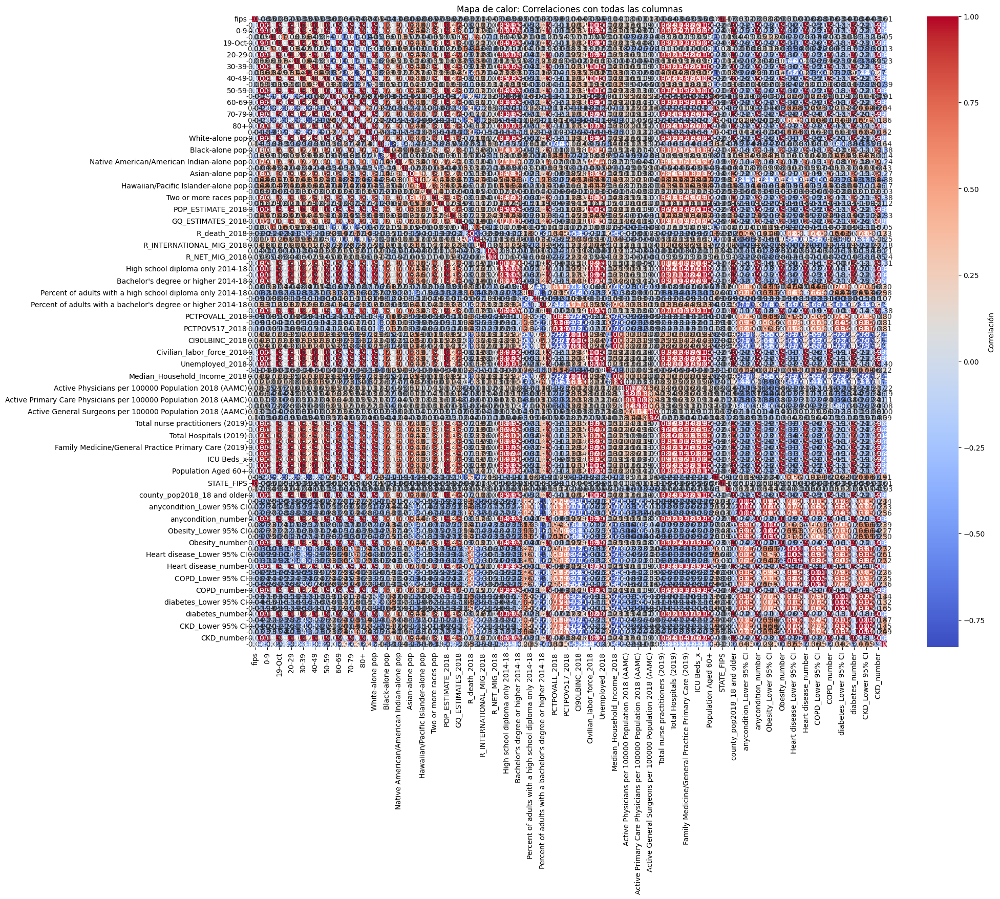

In [144]:
subset_data = data[variables_numericas]

# Calcular la matriz de correlación
correlation_matrix = subset_data.corr()

# Crear un mapa de calor con los porcentajes
plt.figure(figsize=(20, 16))  # Ajustar el tamaño según el número de columnas
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar_kws={'label': 'Correlación'})
plt.title("Mapa de calor: Correlaciones con todas las columnas")
plt.show()

Al haber muchas variables voy a sacar el top correlaciones para poder decidir con qué trabajar

In [145]:
# Calcular la matriz de correlación para todas las variables numéricas
correlation_matrix = data[variables_numericas].corr()

# Ordenar las correlaciones por su valor absoluto (más fuertes primero)
correlation_pairs = correlation_matrix.unstack().sort_values(key=abs, ascending=False)

# Eliminar correlaciones duplicadas (entre la misma variable)
correlation_pairs = correlation_pairs[correlation_pairs < 1.0]

# Mostrar el top de correlaciones más fuertes
top_correlations = correlation_pairs.drop_duplicates().head(50)
print(top_correlations)

STATE_FIPS                   fips                            0.999975
Civilian_labor_force_2018    Employed_2018                   0.999965
Total Population             TOT_POP                         0.999650
TOT_POP                      county_pop2018_18 and older     0.999508
Total Population             county_pop2018_18 and older     0.999499
anycondition_prevalence      anycondition_Upper 95% CI       0.998812
anycondition_Lower 95% CI    anycondition_prevalence         0.998643
Obesity_number               anycondition_number             0.998528
diabetes_Upper 95% CI        diabetes_prevalence             0.998409
county_pop2018_18 and older  Civilian_labor_force_2018       0.998328
Obesity_Upper 95% CI         Obesity_prevalence              0.998239
Obesity_prevalence           Obesity_Lower 95% CI            0.998117
county_pop2018_18 and older  Employed_2018                   0.998080
diabetes_prevalence          diabetes_Lower 95% CI           0.998069
TOT_POP             

In [146]:
# dividir por rangos de edad
# prevalencias de diabetes, enfermedad renal crónica (CKD), y EPOC (COPD) como enfermedades crónicas?
# variable target (cdk o diabetes? )


Voy a crear mi variable target 'chronic_disease_number" con diabetes, CKD y CODP.

In [147]:
data['chronic_disease_number'] = data[['diabetes_number', 'CKD_number', 'COPD_number']].sum(axis=1)


In [148]:
# Filtrar solo las columnas numéricas
numeric_data = data.select_dtypes(include=['float64', 'int64'])

# Calcular las correlaciones de la nueva variable con las demás numéricas
correlations = numeric_data.corr()['chronic_disease_number'].sort_values(ascending=False)

# Mostrar las correlaciones más fuertes (positivas y negativas)
top_positive_correlations = correlations.head(10)  # Correlaciones positivas más altas
top_negative_correlations = correlations.tail(10)  # Correlaciones negativas más fuertes

# Mostrar las correlaciones
print("Top correlaciones positivas:")
print(top_positive_correlations)

print("\nTop correlaciones negativas:")
print(top_negative_correlations)


Top correlaciones positivas:
chronic_disease_number    1.000000
CKD_number                0.998131
diabetes_number           0.998103
anycondition_number       0.996048
Heart disease_number      0.995826
COPD_number               0.993390
Obesity_number            0.991966
Total Population          0.991467
TOT_POP                   0.991075
POP_ESTIMATE_2018         0.991075
Name: chronic_disease_number, dtype: float64

Top correlaciones negativas:
COPD_Upper 95% CI                                           -0.221922
Obesity_prevalence                                          -0.222594
anycondition_prevalence                                     -0.227196
anycondition_Upper 95% CI                                   -0.242041
Obesity_Upper 95% CI                                        -0.242779
Heart disease_Lower 95% CI                                  -0.254062
Heart disease_prevalence                                    -0.263735
Heart disease_Upper 95% CI                              

/tmp/ipykernel_558/3975873457.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_correlations.index, y=top_correlations.values, palette="coolwarm")


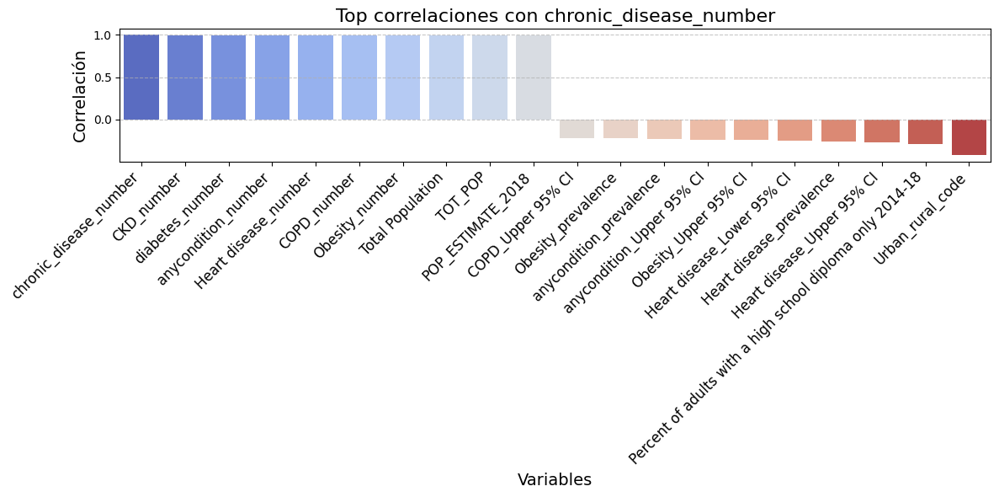

In [149]:


# Crear un DataFrame con las correlaciones más fuertes
top_correlations = pd.concat([top_positive_correlations, top_negative_correlations])

# Graficar las correlaciones
plt.figure(figsize=(12, 6))
sns.barplot(x=top_correlations.index, y=top_correlations.values, palette="coolwarm")
plt.title("Top correlaciones con chronic_disease_number", fontsize=16)
plt.xlabel("Variables", fontsize=14)
plt.ylabel("Correlación", fontsize=14)
plt.xticks(rotation=45, ha="right", fontsize=12)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()


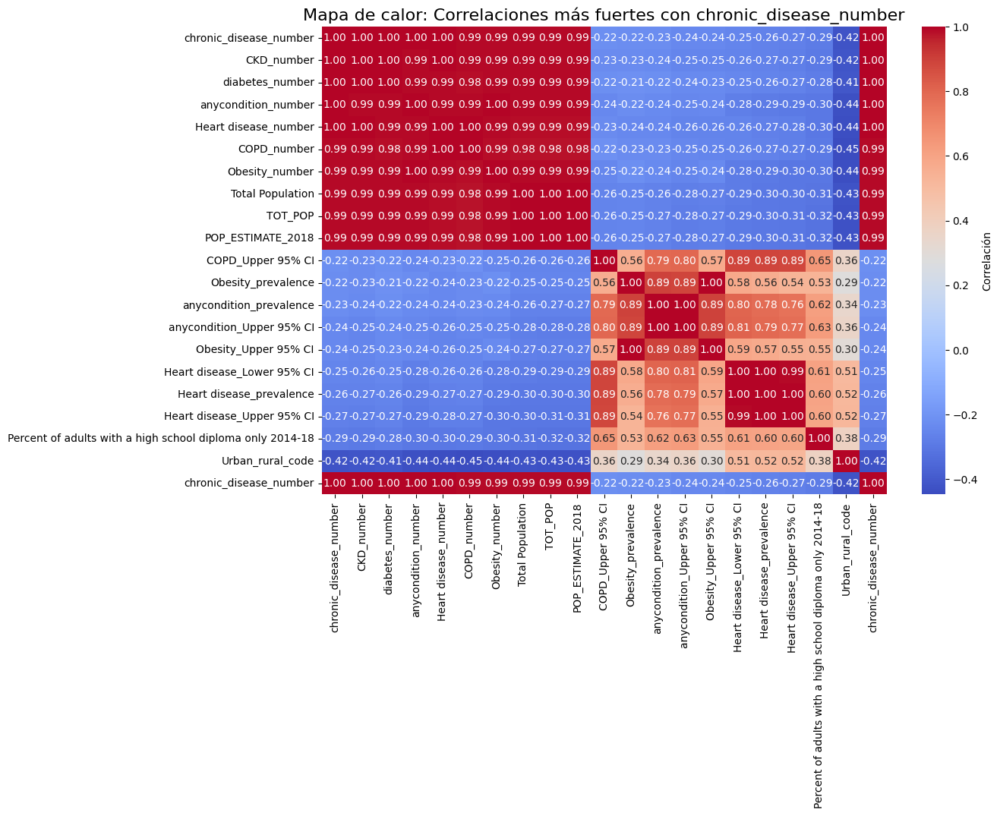

In [150]:


# Crear un subconjunto de las variables con mayores correlaciones
top_variables = top_positive_correlations.index.tolist() + top_negative_correlations.index.tolist()

# Submatriz de correlación
heatmap_data = data[top_variables + ['chronic_disease_number']].corr()

# Crear el mapa de calor
plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, annot=True, fmt=".2f", cmap="coolwarm", cbar_kws={'label': 'Correlación'})
plt.title("Mapa de calor: Correlaciones más fuertes con chronic_disease_number", fontsize=16)
plt.show()


In [151]:
# Configurar Pandas para mostrar todas las columnas sin truncar
pd.set_option('display.max_columns', None)

list(data.columns)


['fips',
 'TOT_POP',
 '0-9',
 '0-9 y/o % of total pop',
 '19-Oct',
 '10-19 y/o % of total pop',
 '20-29',
 '20-29 y/o % of total pop',
 '30-39',
 '30-39 y/o % of total pop',
 '40-49',
 '40-49 y/o % of total pop',
 '50-59',
 '50-59 y/o % of total pop',
 '60-69',
 '60-69 y/o % of total pop',
 '70-79',
 '70-79 y/o % of total pop',
 '80+',
 '80+ y/o % of total pop',
 'White-alone pop',
 '% White-alone',
 'Black-alone pop',
 '% Black-alone',
 'Native American/American Indian-alone pop',
 '% NA/AI-alone',
 'Asian-alone pop',
 '% Asian-alone',
 'Hawaiian/Pacific Islander-alone pop',
 '% Hawaiian/PI-alone',
 'Two or more races pop',
 '% Two or more races',
 'POP_ESTIMATE_2018',
 'N_POP_CHG_2018',
 'GQ_ESTIMATES_2018',
 'R_birth_2018',
 'R_death_2018',
 'R_NATURAL_INC_2018',
 'R_INTERNATIONAL_MIG_2018',
 'R_DOMESTIC_MIG_2018',
 'R_NET_MIG_2018',
 'Less than a high school diploma 2014-18',
 'High school diploma only 2014-18',
 "Some college or associate's degree 2014-18",
 "Bachelor's degree or 

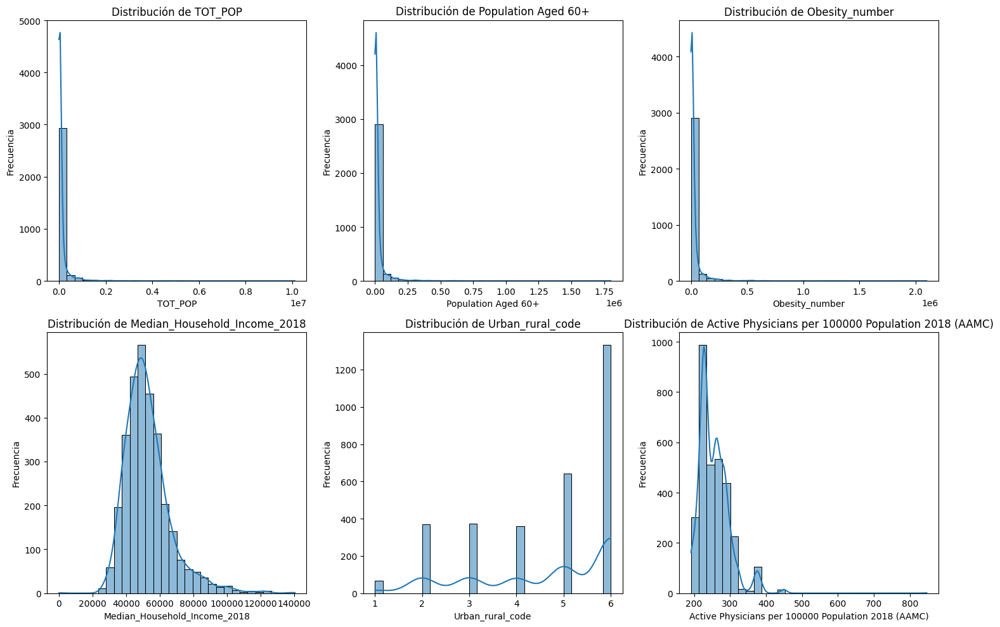

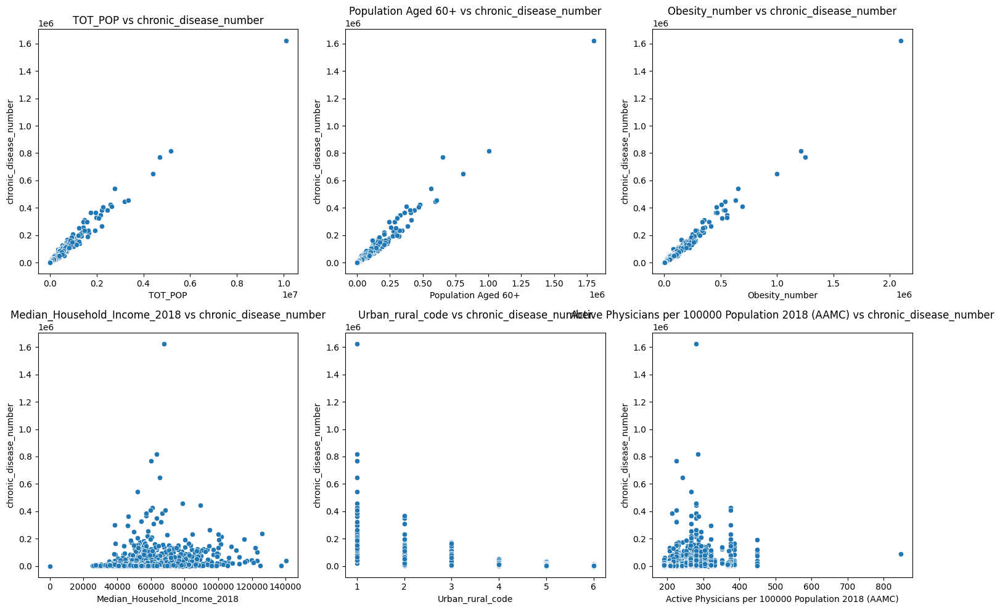

In [152]:
final_features = [
    'TOT_POP', 
    'Population Aged 60+', 
    'Obesity_number', 
    'Median_Household_Income_2018', 
    'Urban_rural_code', 
    'Active Physicians per 100000 Population 2018 (AAMC)'
]

# Crear X e y con estas variables seleccionadas
X = data[final_features]
y = data['chronic_disease_number']

# Volver a generar gráficos con las final_features actualizadas
# Histogramas
plt.figure(figsize=(15, 10))
for i, feature in enumerate(final_features):
    plt.subplot(2, 3, i + 1)
    sns.histplot(data[feature], kde=True, bins=30)
    plt.title(f"Distribución de {feature}")
    plt.xlabel(feature)
    plt.ylabel("Frecuencia")

plt.tight_layout()
plt.show()

# Gráficos de dispersión con chronic_disease_number
plt.figure(figsize=(15, 10))
for i, feature in enumerate(final_features):
    plt.subplot(2, 3, i + 1)
    sns.scatterplot(x=data[feature], y=data['chronic_disease_number'])
    plt.title(f"{feature} vs chronic_disease_number")
    plt.xlabel(feature)
    plt.ylabel("chronic_disease_number")

plt.tight_layout()
plt.show()

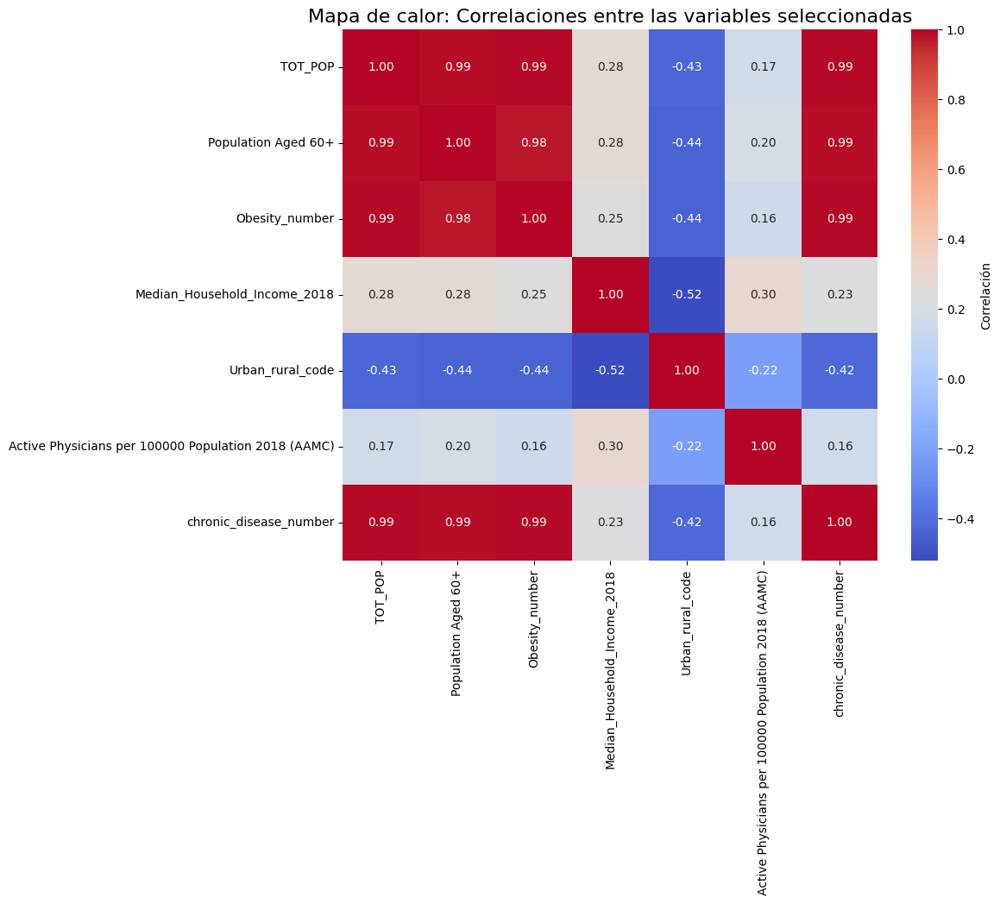

In [153]:

plt.figure(figsize=(10, 8))
correlation_matrix = data[final_features + ['chronic_disease_number']].corr()
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar_kws={'label': 'Correlación'})
plt.title("Mapa de calor: Correlaciones entre las variables seleccionadas", fontsize=16)
plt.show()





In [154]:
print(variables_categoricas)

Index(['COUNTY_NAME', 'STATE_NAME'], dtype='object')


In [155]:
# Agrupar por STATE_NAME para analizar la distribución de Urban_rural_code
urban_rural_by_state = data.groupby('STATE_NAME')['Urban_rural_code'].value_counts().unstack()

# Agrupar por COUNTY_NAME para mayor granularidad
urban_rural_by_county = data[['COUNTY_NAME', 'Urban_rural_code']].value_counts().reset_index(name='Count')

# Mostrar directamente en la consola la distribución de Urban_rural_code por estado y condado

print("Distribución de Urban_rural_code por Estado:")
print(urban_rural_by_state)

print("\nDistribución de Urban_rural_code por Condado:")
print(urban_rural_by_county)



Distribución de Urban_rural_code por Estado:
Urban_rural_code        1     2     3     4     5      6
STATE_NAME                                              
Alabama               1.0   6.0   8.0  14.0  10.0   28.0
Alaska                NaN   NaN   2.0   1.0   2.0   22.0
Arizona               1.0   1.0   1.0   5.0   4.0    3.0
Arkansas              NaN   1.0  11.0   8.0  17.0   38.0
California            8.0   8.0  13.0   8.0   8.0   13.0
Colorado              1.0   9.0   5.0   2.0  11.0   36.0
Connecticut           1.0   2.0   4.0   NaN   1.0    NaN
Delaware              NaN   1.0   1.0   1.0   NaN    NaN
District of Columbia  1.0   NaN   NaN   NaN   NaN    NaN
Florida               5.0  11.0  19.0   9.0   7.0   16.0
Georgia               1.0  28.0  15.0  30.0  28.0   57.0
Hawaii                NaN   NaN   1.0   2.0   2.0    NaN
Idaho                 NaN   NaN   5.0   7.0  15.0   17.0
Illinois              1.0  16.0  10.0  13.0  24.0   38.0
Indiana               1.0  22.0   7.0  14.0

Según parece 1 se a centos más problados en orden descendetente hasta el 6 que serían los lugares más rurales y despoblados

In [156]:
# La y la definí anteriormente cuando metí todas las enfermedades crónicas en una sola varialbe "chronic_disease_number"
# Usar 'Obesity_number' como predictor
X_single = X[['Obesity_number']]

# Dividir los datos 
X_train_single, X_test_single, y_train_single, y_test_single = train_test_split(
    X_single, y, test_size=0.2, random_state=42
)


Entrenamiento del modelo

In [157]:

# Entrenar un modelo de regresión lineal simple
reg_lin_single = LinearRegression()
reg_lin_single.fit(X_train_single, y_train_single)

# Hacer predicciones
y_pred_single = reg_lin_single.predict(X_test_single)

# Evaluar el rendimiento del modelo
mse_single = mean_squared_error(y_test_single, y_pred_single)
rmse_single = np.sqrt(mse_single)
r2_single = r2_score(y_test_single, y_pred_single)

# Resultados del modelo 
rendimiento_single = {
    "MSE": mse_single,
    "RMSE": rmse_single,
    "R²": r2_single
}

rendimiento_single


{'MSE': np.float64(27002095.463708706),
 'RMSE': np.float64(5196.354054883935),
 'R²': 0.9713846024903108}

Regularización Lasso

In [158]:
# Regularización Lasso con 'Obesity_number'
alpha_lasso = 0.1  # Valor inicial de penalización
reg_lasso_single = Lasso(alpha=alpha_lasso, max_iter=4000)
reg_lasso_single.fit(X_train_single, y_train_single)
y_pred_lasso_single = reg_lasso_single.predict(X_test_single)

# Evaluar el rendimiento
mse_lasso_single = mean_squared_error(y_test_single, y_pred_lasso_single)
rmse_lasso_single = np.sqrt(mse_lasso_single)
r2_lasso_single = r2_score(y_test_single, y_pred_lasso_single)

Regularización Ridge

In [159]:
alpha_ridge = 0.1  # Valor inicial de penalización
reg_ridge_single = Ridge(alpha=alpha_ridge, max_iter=4000)
reg_ridge_single.fit(X_train_single, y_train_single)
y_pred_ridge_single = reg_ridge_single.predict(X_test_single)

# Evaluar el rendimiento
mse_ridge_single = mean_squared_error(y_test_single, y_pred_ridge_single)
rmse_ridge_single = np.sqrt(mse_ridge_single)
r2_ridge_single = r2_score(y_test_single, y_pred_ridge_single)


In [160]:
#Resultados de los modelos regularizados con una sola variable
resultados_single_regularizado = pd.DataFrame({
    "Modelo": ["Lasso (alpha=0.1)", "Ridge (alpha=0.1)"],
    "MSE": [mse_lasso_single, mse_ridge_single],
    "RMSE": [rmse_lasso_single, rmse_ridge_single],
    "R²": [r2_lasso_single, r2_ridge_single]
})

print("Resultados de las Regularizaciones con Obesity_number:")
print(resultados_single_regularizado)

Resultados de las Regularizaciones con Obesity_number:
              Modelo           MSE         RMSE        R²
0  Lasso (alpha=0.1)  2.700210e+07  5196.354054  0.971385
1  Ridge (alpha=0.1)  2.700210e+07  5196.354055  0.971385


En este caso los resultados son insensibles a la modificación de los parámetros de regularización. Vamos a probar a hacerlo con más variables.

In [161]:
# Entrenamiento con todas las variables seleccionadas (final_features)

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train_full, X_test_full, y_train_full, y_test_full = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Almacenar resultados para las regularizaciones con el conjunto completo
resultados_full_regularizacion = {'Modelo': [], 'Alpha': [], 'MSE': [], 'RMSE': [], 'R²': []}


# Modelo completo con todas las variables seleccionadas y regularizaciones simples

# 1. Regresión Lineal
reg_lin_full = LinearRegression()
reg_lin_full.fit(X_train_full, y_train_full)
y_pred_lin_full = reg_lin_full.predict(X_test_full)
mse_rl_full = mean_squared_error(y_test_full, y_pred_lin_full)
rmse_rl_full = np.sqrt(mse_rl_full)
r2_rl_full = r2_score(y_test_full, y_pred_lin_full)

# 2. Lasso Regularization
reg_lasso_full = Lasso(alpha=5, max_iter=4000)
reg_lasso_full.fit(X_train_full, y_train_full)
y_pred_lasso_full = reg_lasso_full.predict(X_test_full)
mse_lasso_full = mean_squared_error(y_test_full, y_pred_lasso_full)
rmse_lasso_full = np.sqrt(mse_lasso_full)
r2_lasso_full = r2_score(y_test_full, y_pred_lasso_full)

# 3. Ridge Regularization
reg_ridge_full = Ridge(alpha=6, max_iter=400)
reg_ridge_full.fit(X_train_full, y_train_full)
y_pred_ridge_full = reg_ridge_full.predict(X_test_full)
mse_ridge_full = mean_squared_error(y_test_full, y_pred_ridge_full)
rmse_ridge_full = np.sqrt(mse_ridge_full)
r2_ridge_full = r2_score(y_test_full, y_pred_ridge_full)

# Comparar resultados en un DataFrame
resultados_modelos_completo = pd.DataFrame({
    'Modelo': ['Regresión Lineal', 'Lasso (alpha=0.1)', 'Ridge (alpha=0.1)'],
    'MSE': [mse_rl_full, mse_lasso_full, mse_ridge_full],
    'RMSE': [rmse_rl_full, rmse_lasso_full, rmse_ridge_full],
    'R²': [r2_rl_full, r2_lasso_full, r2_ridge_full]
})

# Mostrar resultados
print("Resultados de los modelos completos:")
print(resultados_modelos_completo)

# Guardar resultados
resultados_modelos_completo.to_csv('resultados_modelos_completo.csv', index=False)
print("Resultados guardados en 'resultados_modelos_completo.csv'.")



Resultados de los modelos completos:
              Modelo           MSE         RMSE        R²
0   Regresión Lineal  1.423053e+07  3772.336928  0.984919
1  Lasso (alpha=0.1)  1.423254e+07  3772.604105  0.984917
2  Ridge (alpha=0.1)  1.423054e+07  3772.338334  0.984919
Resultados guardados en 'resultados_modelos_completo.csv'.


Me doy cuenta de que existe la variable "anycondition_number" que parece ser la que contea las personas con alguna enfermedad crónica (si tiene por ejemplo dos enfermedades crónicas se contaría solo una)
cambio la target :) 

In [162]:
# Redefinir la variable objetivo como anycondition_number
y = data['anycondition_number']

# Dividir los datos en conjuntos de entrenamiento y prueba con el nuevo target
X_train_new, X_test_new, y_train_new, y_test_new = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Entrenar los modelos con el nuevo target

# 1. Regresión Lineal
reg_lin_new = LinearRegression()
reg_lin_new.fit(X_train_new, y_train_new)
y_pred_lin_new = reg_lin_new.predict(X_test_new)
mse_rl_new = mean_squared_error(y_test_new, y_pred_lin_new)
rmse_rl_new = np.sqrt(mse_rl_new)
r2_rl_new = r2_score(y_test_new, y_pred_lin_new)

# 2. Lasso Regularization
reg_lasso_new = Lasso(alpha=0.1, max_iter=8000)
reg_lasso_new.fit(X_train_new, y_train_new)
y_pred_lasso_new = reg_lasso_new.predict(X_test_new)
mse_lasso_new = mean_squared_error(y_test_new, y_pred_lasso_new)
rmse_lasso_new = np.sqrt(mse_lasso_new)
r2_lasso_new = r2_score(y_test_new, y_pred_lasso_new)

# 3. Ridge Regularization
reg_ridge_new = Ridge(alpha=0.1, max_iter=400)
reg_ridge_new.fit(X_train_new, y_train_new)
y_pred_ridge_new = reg_ridge_new.predict(X_test_new)
mse_ridge_new = mean_squared_error(y_test_new, y_pred_ridge_new)
rmse_ridge_new = np.sqrt(mse_ridge_new)
r2_ridge_new = r2_score(y_test_new, y_pred_ridge_new)

# Comparar resultados en un DataFrame
resultados_modelos_new = pd.DataFrame({
    'Modelo': ['Regresión Lineal', 'Lasso (alpha=0.1)', 'Ridge (alpha=0.1)'],
    'MSE': [mse_rl_new, mse_lasso_new, mse_ridge_new],
    'RMSE': [rmse_rl_new, rmse_lasso_new, rmse_ridge_new],
    'R²': [r2_rl_new, r2_lasso_new, r2_ridge_new]
})

# Mostrar resultados
print("Resultados con el nuevo target (anycondition_number):")
print(resultados_modelos_new)

# Guardar resultados
resultados_modelos_new.to_csv('resultados_modelos_anycondition.csv', index=False)
print("Resultados guardados en 'resultados_modelos_anycondition.csv'.")


Resultados con el nuevo target (anycondition_number):
              Modelo           MSE         RMSE        R²
0   Regresión Lineal  9.715596e+06  3116.985117  0.997341
1  Lasso (alpha=0.1)  9.715579e+06  3116.982290  0.997341
2  Ridge (alpha=0.1)  9.715596e+06  3116.985078  0.997341
Resultados guardados en 'resultados_modelos_anycondition.csv'.
